## CNN Classifier

#### Preparem dades

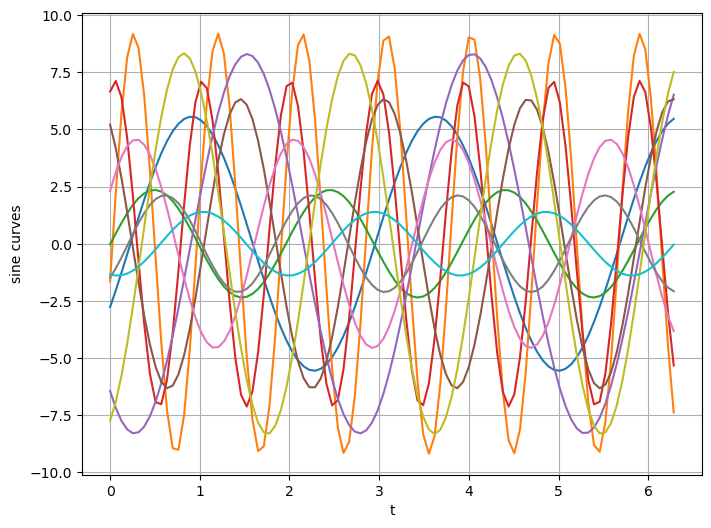

Training Data Min: -9.971634743554423, Max: 9.97002067618758
Validation Data Min: -9.99206716230304, Max: 9.98963272300556
Target Data Min: 0.0, Max: 1.0


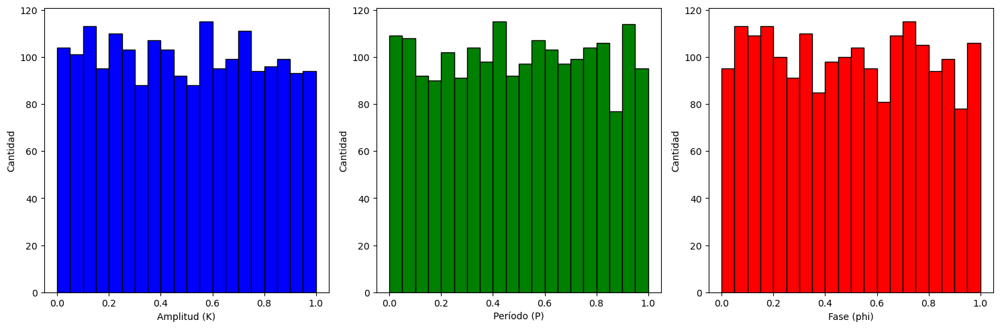

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from IPython.display import clear_output
from IPython.display import display
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import optuna



data = np.loadtxt("Sinusoid_ML.dat")
P, K, phi = data[:, 0], data[:, 1], data[:, 2]


t = np.linspace(0, 2 * np.pi, 100)
#sine_curves = np.array([K[i] * np.sin(2 * np.pi * t / P[i] + 0) for i in range(len(P))])
sine_curves = data[:,3:103]
#sine_curves = (sine_curves - sine_curves.min()) / (sine_curves.max() - sine_curves.min())

plt.figure(figsize=(8, 6))
for i in range(10):
    plt.plot(t, sine_curves[i], label=f'Curve {i+1}')

plt.xlabel("t")
plt.ylabel("sine curves")
plt.grid()
plt.show()


P_norm = (P - P.min()) / (P.max() - P.min())
K_norm = (K - K.min()) / (K.max() - K.min())
phi_norm = (phi - phi.min()) / (phi.max() - phi.min())
#phi_norm[:]=0


target_params = np.vstack([K_norm, P_norm, phi_norm]).T # transposta: cada fila 3 parametres

# 70% train, 15% val, 15% test
sine_train, sine_temp, target_train, target_temp = train_test_split(sine_curves, target_params, test_size=0.3, random_state=26)
sine_val, sine_test, target_val, target_test = train_test_split(sine_temp, target_temp, test_size=0.5, random_state=26)

print(f"Training Data Min: {sine_train.min()}, Max: {sine_train.max()}")
print(f"Validation Data Min: {sine_val.min()}, Max: {sine_val.max()}")
print(f"Target Data Min: {target_train.min()}, Max: {target_train.max()}")


#sine_train = torch.tensor(sine_train, dtype=torch.float32)
sine_train = torch.tensor(sine_train, dtype=torch.float32).reshape(-1, 1, 100)
#sine_val = torch.tensor(sine_val, dtype=torch.float32)
sine_val = torch.tensor(sine_val, dtype=torch.float32).reshape(-1, 1, 100)
# sine_test = torch.tensor(sine_test, dtype=torch.float32)
sine_test = torch.tensor(sine_test, dtype=torch.float32).reshape(-1, 1, 100)
target_train = torch.tensor(target_train, dtype=torch.float32)
target_val = torch.tensor(target_val, dtype=torch.float32)
target_test = torch.tensor(target_test, dtype=torch.float32)


plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.hist(K_norm, bins=20, color='b', edgecolor='black')
plt.xlabel('Amplitud (K)')
plt.ylabel('Cantidad')

plt.subplot(1, 3, 2)
plt.hist(P_norm, bins=20, color='g', edgecolor='black')
plt.xlabel('Período (P)')
plt.ylabel('Cantidad')

plt.subplot(1, 3, 3)
plt.hist(phi_norm, bins=20, color='r', edgecolor='black')
plt.xlabel('Fase (phi)')
plt.ylabel('Cantidad')


plt.tight_layout()
plt.show()



### Optuna test

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import optuna
import matplotlib.pyplot as plt

def objective(trial):
    # Hiperparàmetres a optimitzar
    lr = trial.suggest_float("lr", 1e-5, 1e-2, log=True)
    hidden1 = trial.suggest_int("hidden1", 64, 300)
    hidden2 = trial.suggest_int("hidden2", 64, 300)
    batch_size = trial.suggest_categorical("batch_size", [32, 64, 128])

    class CNNModel(nn.Module):
        def __init__(self):
            super(CNNModel, self).__init__()
            self.conv1 = nn.Conv1d(in_channels=1, out_channels=4, kernel_size=3, padding=1)
            self.conv2 = nn.Conv1d(in_channels=4, out_channels=12, kernel_size=3, padding=1)
            self.flatten = nn.Flatten()
            self.fc1 = nn.Linear(12 * 100, hidden1)
            self.fc2 = nn.Linear(hidden1, hidden2)
            self.fc3 = nn.Linear(hidden2, 3)

        def forward(self, x):
            x = self.conv1(x)
            x = F.relu(self.conv2(x))
            x = self.flatten(x)
            x = F.relu(self.fc1(x))
            x = F.relu(self.fc2(x))
            x = self.fc3(x)
            return x

    model = CNNModel()
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    dataset = torch.utils.data.TensorDataset(sine_train, target_train)
    dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)
    val_dataset = torch.utils.data.TensorDataset(sine_val, target_val)
    val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    num_epochs = 25  # pots ajustar aquest valor
    for epoch in range(num_epochs):
        model.train()
        for batch_x, batch_y in dataloader:
            optimizer.zero_grad()
            outputs = model(batch_x)
            loss = criterion(outputs, batch_y)
            loss.backward()
            optimizer.step()

    # Validació després de l'última època
    model.eval()
    val_loss_total = 0.0
    with torch.no_grad():
        for val_x, val_y in val_dataloader:
            val_outputs = model(val_x)
            val_loss = criterion(val_outputs, val_y)
            val_loss_total += val_loss.item()

    avg_val_loss = val_loss_total / len(val_dataloader)
    return avg_val_loss


# Optimització amb Optuna
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=30)

print("Millors hiperparàmetres:")
print(study.best_params)


[I 2025-05-05 10:16:42,524] A new study created in memory with name: no-name-bdda452a-5402-493b-9865-f7817ec39581
[I 2025-05-05 10:16:46,000] Trial 0 finished with value: 0.010659575772782167 and parameters: {'lr': 0.00019223781756736317, 'hidden1': 262, 'hidden2': 283, 'batch_size': 128}. Best is trial 0 with value: 0.010659575772782167.
[I 2025-05-05 10:16:48,519] Trial 1 finished with value: 0.008398458454757929 and parameters: {'lr': 0.0051143324445226, 'hidden1': 154, 'hidden2': 84, 'batch_size': 64}. Best is trial 1 with value: 0.008398458454757929.
[I 2025-05-05 10:16:51,975] Trial 2 finished with value: 0.02433460410684347 and parameters: {'lr': 1.469695500897364e-05, 'hidden1': 77, 'hidden2': 241, 'batch_size': 32}. Best is trial 1 with value: 0.008398458454757929.
[I 2025-05-05 10:16:54,676] Trial 3 finished with value: 0.00685729905962944 and parameters: {'lr': 0.0007251134137711758, 'hidden1': 170, 'hidden2': 295, 'batch_size': 64}. Best is trial 3 with value: 0.00685729905

Millors hiperparàmetres:
{'lr': 0.001930551746321195, 'hidden1': 203, 'hidden2': 151, 'batch_size': 64}


### Training and Validation set

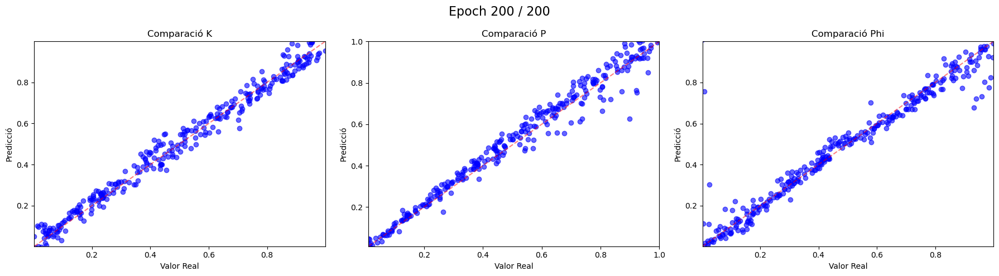

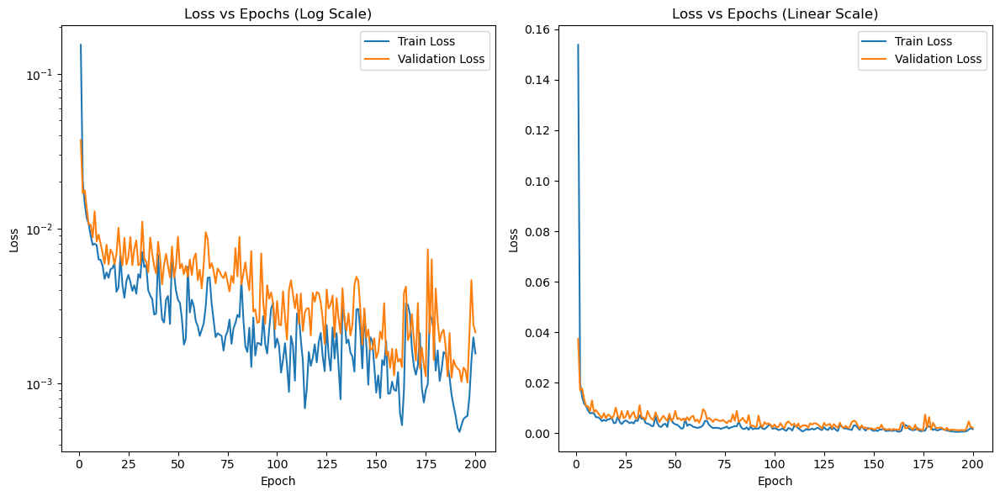

In [15]:
#MODEL Alternatiu
class CNNModel(nn.Module):
    def __init__(self):
        super(CNNModel, self).__init__()
        self.conv1 = nn.Conv1d(in_channels=1, out_channels=4, kernel_size=3, padding=1)  # 'same' padding
        self.conv2 = nn.Conv1d(in_channels=4, out_channels=12, kernel_size=3, padding=1) # 'same' padding
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(12 * 100, 150)  # 12 canales x 100 elementos por canal
        self.fc2 = nn.Linear(150, 150)
        self.fc3 = nn.Linear(150, 3)

    def forward(self, x):
        x = self.conv1(x)  # Conv1D con activación lineal
        x = F.relu(self.conv2(x))  # Conv1D con activación ReLU
        x = self.flatten(x)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)  # Sin activación -> salida lineal
        return x




# Crear el modelo
model = CNNModel()

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0053)

num_epochs = 200
batch_size = 16
dataset = torch.utils.data.TensorDataset(sine_train, target_train)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)
val_dataset = torch.utils.data.TensorDataset(sine_val, target_val)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
train_losses = []
val_losses = []

all_predictions = []

for epoch in range(num_epochs):
    model.train()
    running_train_loss = 0.0

    for batch_x, batch_y in dataloader:
        optimizer.zero_grad()
        outputs = model(batch_x)
        loss = criterion(outputs, batch_y)
        loss.backward()
        optimizer.step()
        running_train_loss += loss.item() * batch_x.size(0)

    avg_train_loss = running_train_loss / len(dataloader.dataset)
    train_losses.append(avg_train_loss)
    
    model.eval()
    running_val_loss = 0.0
    with torch.no_grad():
        for val_x, val_y in val_dataloader:
            val_outputs = model(val_x)
            val_loss = criterion(val_outputs, val_y)
            running_val_loss += val_loss.item() * val_x.size(0)
            
    
    avg_val_loss = running_val_loss / len(val_dataloader.dataset)
    val_losses.append(avg_val_loss)
    
    with torch.no_grad():
        predict = model(sine_test).numpy()
    all_predictions.append(predict)
    params = target_test.numpy()
    
    # plot (animacion a partir de aqui)
    # Actualitzar gràfic en viu dins del notebook
    clear_output(wait=True)
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))

    titles = ["Comparació K", "Comparació P", "Comparació Phi"]
    for i, ax in enumerate(axes):
        ax.scatter(params[:, i], predict[:, i], color='blue', alpha=0.6)
        ax.set_title(titles[i])
        ax.set_xlabel("Valor Real")
        ax.set_ylabel("Predicció")
        ax.set_xlim(params[:, i].min(), params[:, i].max())
        ax.set_ylim(params[:, i].min(), params[:, i].max())
        ax.plot([params[:, i].min(), params[:, i].max()], 
                [params[:, i].min(), params[:, i].max()], 'r--', alpha=0.5)

    fig.suptitle(f"Epoch {epoch+1} / {num_epochs}", fontsize=16)
    plt.tight_layout()
    plt.show()


    # animacion hasta aqui
    if epoch % 10 == 0:
        print(f"Epoch [{epoch}/{num_epochs}], Train Loss: {avg_train_loss:.6f}, Val Loss: {avg_val_loss:.6f}")




epochs = range(1, num_epochs + 1)

plt.figure(figsize=(12, 6))

# Log scale
plt.subplot(1, 2, 1)
plt.plot(epochs, train_losses, label="Train Loss")
plt.plot(epochs, val_losses, label="Validation Loss")
plt.yscale('log')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss vs Epochs (Log Scale)")
plt.legend()

# Linear scale
plt.subplot(1, 2, 2)
plt.plot(epochs, train_losses, label="Train Loss")
plt.plot(epochs, val_losses, label="Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss vs Epochs (Linear Scale)")
plt.legend()

plt.tight_layout()
plt.show()

#### Animation

In [16]:
%matplotlib inline



params = target_test.numpy()  # Reales

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
scatters = [ax.scatter([], [], alpha=0.6) for ax in axes]

titles = ["Comparació K", "Comparació P", "Comparació Phi"]
for ax, title in zip(axes, titles):
    ax.set_xlabel("Valor Real")
    ax.set_ylabel("Predicció")
    ax.set_xlim(np.min(params), np.max(params))
    ax.set_ylim(np.min(params), np.max(params))
    ax.set_title(title)

def update(frame):
    pred = all_predictions[frame]
    for i in range(3):
        scatters[i].set_offsets(np.column_stack((params[:, i], pred[:, i])))
    fig.suptitle(f"Epoch {frame+1}", fontsize=16)
    return scatters

ani = FuncAnimation(fig, update, frames=len(all_predictions), interval=200, blit=False)

HTML(ani.to_jshtml())

Animation size has reached 21112887 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### Evaluation set

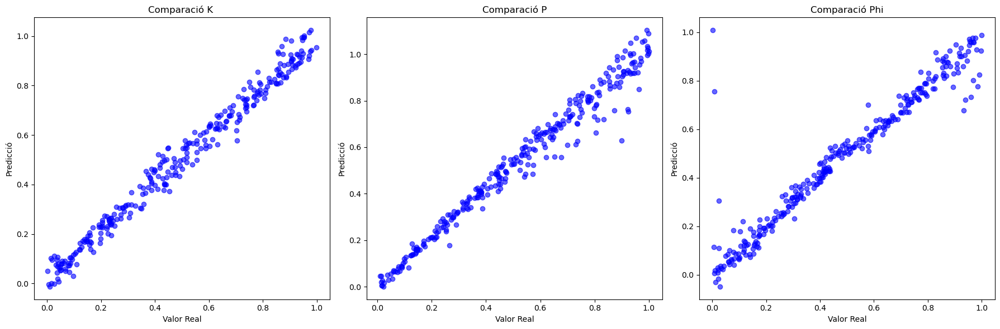

In [21]:
# evaluation
model.eval()
with torch.no_grad():
    predict = model(sine_test)


predict = predict.numpy()
params = target_test.numpy()
# plot
plt.figure(figsize=(18, 6))

# K
plt.subplot(1, 3, 1)
plt.scatter(params[:, 0], predict[:, 0], color='blue', alpha=0.6)
plt.title("Comparació K ")
plt.xlabel("Valor Real")
plt.ylabel("Predicció")

# P
plt.subplot(1, 3, 2)
plt.scatter(params[:, 1], predict[:, 1], color='blue', alpha=0.6)
plt.title("Comparació P")
plt.xlabel("Valor Real")
plt.ylabel("Predicció")

# Phi
plt.subplot(1, 3, 3)
plt.scatter(params[:, 2], predict[:, 2], color='blue', alpha=0.6)
plt.title("Comparació Phi")
plt.xlabel("Valor Real")
plt.ylabel("Predicció")

plt.tight_layout()
plt.savefig('plot.png')
plt.show()
